##Create JSON query dataset

In [4]:
#double-check ipython starting directory. Should be "/root/ds210_capstone/caffe_script/model"
!pwd

/root/ds210_capstone/caffe_script/model


In [24]:
%%writefile json_query.py
import sys
import json

limit=int(sys.argv[1])
inputname=sys.argv[2]
outputname=sys.argv[3]

output={}
count=0

with open(outputname,'w+') as outputfile:
    with open(inputname,'r') as inputfile:        
        for line in inputfile:

            if count>=limit: break

            post = json.loads(line)

            #read json but need to handle index error as certain lines of JSON has errors
            #during as we attempt to extract the value in image_url
            try:
                feed_id = post['feed'][0]['id']
                image_url = post['feed'][0]['images']['standard_resolution']
                #figure out filename
                output[feed_id]=image_url
                count+=1

            except IndexError:
                print "Index error with line of JSON: ignore and go to next line of JSON"

        outputfile.write(json.dumps(output))

Overwriting json_query.py


In [25]:
!python json_query.py 10 ../../../dataset/feeds.json ../../../dataset/query.json

In [ ]:
!cat ../../../dataset/query.json

In [24]:
%%writefile baseline.py
#Grab new images
import ast
import os
import json
import urllib
import posixpath
import urlparse 
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import os
import caffe
import sys

class Baseline:
    index=0
    limit=999
    num_images=0
    num_guesses=5
    images = {}
    predictions = {}
    DATA_PATH = "../../../dataset/"
    caffe_root = '../../../caffe/'

    #main function for running the baseline script
    def baseline_run(self,request):
        self.generate_image(request)
        self.caffe_setup()
        self.caffe_predict()
        return self.predictions

    #generate images
    def generate_image(self,request):
        #clean up temp file
        for f in os.listdir(self.DATA_PATH+"temp/"):
            os.remove(self.DATA_PATH+"temp/"+f)
           
        #for each feed_id, create image and set index for images
        for feed_id, image_url in request.iteritems():
            
            #read json but need to handle index error as certain lines of JSON has errors
            #during as we attempt to extract the value in image_url
            try:
                #figure out filename
                path = urlparse.urlsplit(image_url).path
                filename = posixpath.basename(path)
                image_path = self.DATA_PATH+"temp/"+filename
                #download to local folder and resize image
                urllib.urlretrieve(image_url,image_path)
                
                #need to handle potential error due to issues not being able to open image file
                try: 
                    img = Image.open(image_path)
                    img.thumbnail((256,256),Image.ANTIALIAS) #best quality
                    #set limit on number of images to process
                    self.index+=1
                    print "file no.",self.index,"processed:",image_path
                    self.images[feed_id]=image_path
                    self.num_images+=1
                    if self.index==self.limit: break
                except IOError:
                    print "Cannot open image: remove image and go to next line of JSON"
                    os.remove(image_path)
                    self.images[feed_id]="NA"

            except IndexError:
                print "Index error with line of JSON: ignore and go to next line of JSON"
                self.images[feed_id]="NA"

                
                
    #Import required modules, set plotting parameters, and run 
    #./scripts/download_model_binary.py models/bvlc_reference_caffenet 
    #to get the pretrained CaffeNet model if it hasn't yet been fetched
    def caffe_setup(self):
        # Make sure that caffe is on the python path:
        sys.path.insert(0, self.caffe_root + 'python')

        plt.rcParams['figure.figsize'] = (10, 10)
        plt.rcParams['image.interpolation'] = 'nearest'
        plt.rcParams['image.cmap'] = 'gray'

        if not os.path.isfile(self.caffe_root + 'models/bvlc_reference_caffenet/bvlc_reference_caffenet.caffemodel'):
            print("Downloading pre-trained CaffeNet model...")
#             !caffe/scripts/download_model_binary.py caffe/models/bvlc_reference_caffenet        
            os.system(self.caffe_root+"scripts/download_model_binary.py caffe/models/bvlc_reference_caffenet")
        
    #Make image predictions
    def caffe_predict(self):
        
        # Set Caffe to CPU mode, load the net in the test phase for inference, and configure input preprocessing.
        caffe.set_mode_cpu()
        net = caffe.Net(self.caffe_root + 'models/bvlc_reference_caffenet/deploy.prototxt',
                    self.caffe_root + 'models/bvlc_reference_caffenet/bvlc_reference_caffenet.caffemodel',
                    caffe.TEST)

        # input preprocessing: 'data' is the name of the input blob == net.inputs[0]
        transformer = caffe.io.Transformer({'data': net.blobs['data'].data.shape})
        transformer.set_transpose('data', (2,0,1))
        transformer.set_mean('data', np.load(self.caffe_root + 'python/caffe/imagenet/ilsvrc_2012_mean.npy').mean(1).mean(1)) # mean pixel
        transformer.set_raw_scale('data', 255)  # the reference model operates on images in [0,255] range instead of [0,1]
        transformer.set_channel_swap('data', (2,1,0))  # the reference model has channels in BGR order instead of RGB

        # set net to batch size to be the total number of images
        net.blobs['data'].reshape(self.num_images,3,227,227)

        
        # load labels
        imagenet_labels_filename = self.caffe_root + 'data/ilsvrc12/synset_words.txt'
        try:
            labels = np.loadtxt(imagenet_labels_filename, str, delimiter='\t')
        except:
#             !../data/ilsvrc12/get_ilsvrc_aux.sh
            os.system(self.caffe_root + 'data/ilsvrc12/get_ilsvrc_aux.sh')

            labels = np.loadtxt(imagenet_labels_filename, str, delimiter='\t')

        # load image data into model
#         for (dirpath, dirnames, filenames) in walk(self.DATA_PATH+"temp/"):
        i=0
        image_ids = {}
        for feed_id, img_path in self.images.iteritems():
            #load image into caffe preprocessor
            net.blobs['data'].data[i] = transformer.preprocess('data',  
                caffe.io.load_image(img_path))
            image_ids[feed_id]=i
            i+=1

        #batch computation step (show computation time)
        net.forward()  # call once for allocation
#         %timeit net.forward()
        
        #display result, showing top 5 prediction for each image
#         for (dirpath, dirnames, filenames) in walk('../../../dataset/images/'):
#             for i,filename in enumerate(filenames):
        for feed_id,i in image_ids.iteritems():
            probs = net.blobs['prob'].data[i].flatten()
            top_probs=probs[-1:-1-self.num_guesses:-1]
            top_k = probs.argsort()[-1:-1-self.num_guesses:-1]
        
            top_predictions = labels[top_k]

            for top_prob,top_prediction in zip(top_probs,top_predictions):
                self.predictions.setdefault(feed_id, [])
                pred_id = top_prediction[:9]
                pred_name = top_prediction[11:]
                self.predictions[feed_id].append({"id":pred_id,"name":pred_name,"score":top_prob}) 



Overwriting baseline.py


In [26]:
#test code
%reload_ext autoreload
%autoreload 2

from baseline import Baseline

request = {"1094301226639611969_1016687101": "https://scontent.cdninstagram.com/hphotos-xfa1/t51.2885-15/e35/12071132_117024925320109_1448778029_n.jpg", "1079932954249514250_1009689594": "https://scontent.cdninstagram.com/hphotos-xaf1/t51.2885-15/s640x640/sh0.08/e35/11377801_146811182334693_2053033951_n.jpg", "901390003869460339_1016673720": "https://scontent.cdninstagram.com/hphotos-xft1/t51.2885-15/e15/10919675_339630669566407_1560505453_n.jpg", "1091411570335070017_1002181196": "https://scontent.cdninstagram.com/hphotos-xaf1/t51.2885-15/s640x640/sh0.08/e35/12139791_172476163092798_682238343_n.jpg", "1085670910110935094_1001957249": "https://scontent.cdninstagram.com/hphotos-xfa1/t51.2885-15/e35/11899529_409336062593154_26859144_n.jpg"}
b = Baseline()
respond = b.baseline_run(request)
print respond

file no. 1 processed: ../../../dataset/temp/12071132_117024925320109_1448778029_n.jpg
file no. 2 processed: ../../../dataset/temp/11899529_409336062593154_26859144_n.jpg
file no. 3 processed: ../../../dataset/temp/12139791_172476163092798_682238343_n.jpg
file no. 4 processed: ../../../dataset/temp/10919675_339630669566407_1560505453_n.jpg
file no. 5 processed: ../../../dataset/temp/11377801_146811182334693_2053033951_n.jpg
{'1094301226639611969_1016687101': [{'score': 0.0036538495, 'id': 'n02536864', 'name': 'oho, cohoe, coho salmon, blue jack, silver salmon, Oncorhynchus kisutch'}, {'score': 0.00026560019, 'id': 'n02640242', 'name': 'turgeon'}, {'score': 3.5026708e-06, 'id': 'n03877472', 'name': "ajama, pyjama, pj's, jammies"}, {'score': 3.1728273e-06, 'id': 'n04429376', 'name': 'hrone'}, {'score': 4.0775785e-06, 'id': 'n02641379', 'name': 'ar, garfish, garpike, billfish, Lepisosteus osseus'}, {'score': 0.0036538495, 'id': 'n02536864', 'name': 'oho, cohoe, coho salmon, blue jack, silv

Import required modules, set plotting parameters, and run ./scripts/download_model_binary.py models/bvlc_reference_caffenet to get the pretrained CaffeNet model if it hasn't already been fetched.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

# Make sure that caffe is on the python path:
caffe_root = '../../../caffe/'  # this file is expected to be in {caffe_root}/examples
import sys
sys.path.insert(0, caffe_root + 'python')

import caffe

plt.rcParams['figure.figsize'] = (10, 10)
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

import os
if not os.path.isfile(caffe_root + 'models/bvlc_reference_caffenet/bvlc_reference_caffenet.caffemodel'):
    print("Downloading pre-trained CaffeNet model...")
    !caffe/scripts/download_model_binary.py caffe/models/bvlc_reference_caffenet

Set Caffe to CPU mode, load the net in the test phase for inference, and configure input preprocessing.

In [2]:
caffe.set_mode_cpu()
net = caffe.Net(caffe_root + 'models/bvlc_reference_caffenet/deploy.prototxt',
                caffe_root + 'models/bvlc_reference_caffenet/bvlc_reference_caffenet.caffemodel',
                caffe.TEST)

# input preprocessing: 'data' is the name of the input blob == net.inputs[0]
transformer = caffe.io.Transformer({'data': net.blobs['data'].data.shape})
transformer.set_transpose('data', (2,0,1))
transformer.set_mean('data', np.load(caffe_root + 'python/caffe/imagenet/ilsvrc_2012_mean.npy').mean(1).mean(1)) # mean pixel
transformer.set_raw_scale('data', 255)  # the reference model operates on images in [0,255] range instead of [0,1]
transformer.set_channel_swap('data', (2,1,0))  # the reference model has channels in BGR order instead of RGB

In [ ]:
# # GPU mode  (NEEED SPIN UP GPU FOR THIS)
# caffe.set_device(0)
# caffe.set_mode_gpu()
# net.forward()  # call once for allocation
# %timeit net.forward()

Make image predictions

In [10]:
from os import walk
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
from math import ceil
%matplotlib inline

# set net to batch size to be the total number of images
net.blobs['data'].reshape(num_images,3,227,227)

# load labels
imagenet_labels_filename = caffe_root + 'data/ilsvrc12/synset_words.txt'
try:
    labels = np.loadtxt(imagenet_labels_filename, str, delimiter='\t')
except:
    !../data/ilsvrc12/get_ilsvrc_aux.sh
    labels = np.loadtxt(imagenet_labels_filename, str, delimiter='\t')

# load image data into model
for (dirpath, dirnames, filenames) in walk('../../../dataset/images/'):
    for i,filename in enumerate(filenames):        
        #load image into caffe preprocessor
        net.blobs['data'].data[i] = transformer.preprocess('data',  
            caffe.io.load_image('../../../dataset/images/'+filename))

#batch computation step (show computation time)
net.forward()  # call once for allocation
%timeit net.forward()

1 loops, best of 3: 6.85 s per loop


Create the plots of the final results

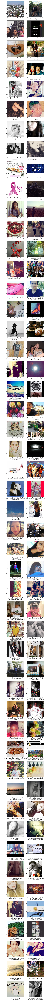

In [13]:
#parameters for creating subplots
num_rows=ceil(float(num_images)/2)
num_cols=2
plt.figure(figsize=(15,num_rows*8))

#display result, showing top 5 prediction for each image
for (dirpath, dirnames, filenames) in walk('../../../dataset/images/'):
    for i,filename in enumerate(filenames):
        top_k = net.blobs['prob'].data[i].flatten().argsort()[-1:-6:-1]
        top_predictions = labels[top_k]
    
        #creating the subplots of image with predictions as xlabel
        ax = plt.subplot(num_rows,num_cols,i+1)
        img = Image.open('../../../dataset/images/'+filename)
        ax.imshow(np.asarray(img))
        plt.xlabel(top_predictions)

#output the results
plt.show()